# ⋆. 𐙚 ̊  Image Stitching  ̊ 𐙚⋆.

**Author**: Maissara Saejun


**Reference**: [Image Stitching with OpenCV](https://www.geeksforgeeks.org/computer-vision/image-stitching-with-opencv/)

**Modification/Improvment**:
* เพิ่มขั้นตอน Preprocessing pipeline (blur + CLAHE + denoise + sharpen) ทำให้ SIFT แม่นยำขึ้น
* ในขั้นตอน Feature Matching เพิ่มการ Filtering ด้วย ratio test ของ Lowe's method และเพิ่มการตรวจสอบ len(good_matches) < 4 → throw error เพื่อป้องกัน homography fail
* ในขั้นตอน Draw Matches เพิ่มการวาดจุดและเส้นเพื่อให้เห็นภาพชัดขึ้น
* ในขั้นตอน Find Homography เพิ่มการตรวจสอบจำนวน inliers (mask.sum()) และเตือนถ้าน้อยเกินไป (< 20) เพื่อให้รู้คุณภาพของ homography ที่ได้
* ในขั้นตอน Warp image เพิ่มการคำนวณ bounding box ของ corner ทั้งสองภาพรวมกัน เพื่อหา xmin, ymin, xmax, ymax และ translation matrix Ht เพื่อเลื่อนภาพไม่ให้ติดพิกัดติดลบ และใช้ warpPerspective() กับ Ht.dot(H) ทำให้ panorama มีขนาดพอดีกับทุก corner วางภาพที่สองลงในตำแหน่งที่ถูกต้อง
* เพิ่มการทำซ้ำแบบ 3 รูปภาพ

**Prompt**:
*   จาก Implementation Steps ต่อไปนี้ Preprocessing > Feature Detection & Matching > Homography Estimation > Transformation Application > Visualization ช่วยทำ โครงร่าง Notebook (Colab) ให้หน่อย หัวข้อ Image stitching
*   ขั้นตอน preprocessing = grayscale + GaussianBlur พอไหม เพิ่มอะไรได้อีกสำหรับ image stitching
*   code ตอน Draw Matches ทำให้เส้นชัดเจนกว่านี้ได้มั้ย



## Connecting google drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
root = "/content/drive/MyDrive/CP461/Mini_Project/images"

## Import Library

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
# ฟังก์ชันช่วยในการแสดงภาพ
def show_img(img, title="Image"):
    plt.figure(figsize=(10,6))

    if len(img.shape) == 2:
        plt.imshow(img, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)) # (h, w, color channel)

    plt.title(title)
    plt.axis("off")
    plt.show()

## Load images


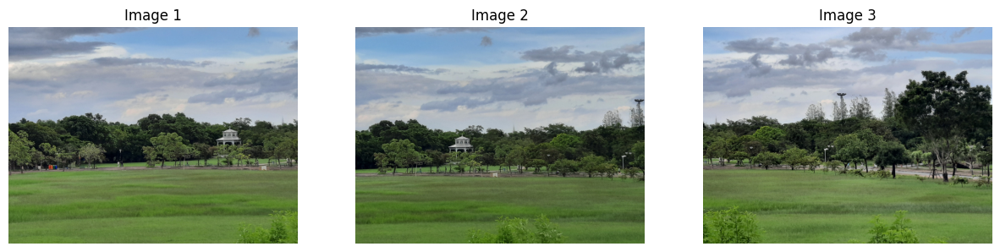

In [ ]:
img1 = cv2.imread(f"{root}/g1.jpg")
img2 = cv2.imread(f"{root}/g2.jpg")
img3 = cv2.imread(f"{root}/g3.jpg")

images = [img1, img2, img3]
titles = ["Image 1", "Image 2", "Image 3"]

plt.figure(figsize=(15, 5))

for i, (img, title) in enumerate(zip(images, titles), 1):
    plt.subplot(1, len(images), i)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis("off")

plt.show()

## Preprocessing

1. Grayscale เพื่อให้ตัวตรวจจับ feature ทำงานบนความเข้มได้ดีและลดข้อมูลที่ไม่จำเป็นของสี
2. GaussianBlur เพื่อลด noise เล็กน้อย ช่วยลด keypoints ที่เป็น noise
3. CLAHE (Contrast Limited Adaptive Histogram Equalization) ปรับ contrast เฉพาะพื้นที่เล็ก ๆ ให้ keypoints ชัดขึ้นในภาพที่มืด/แสงไม่สม่ำเสมอ
4. Denoising ใช้ fastNlMeansDenoising ลด noise แบบ non-local means ที่อาจทำให้ feature detector สับสน
5. Sharpening เพิ่มความคม edge ช่วยให้ได้ keypoints ชัดขึ้น


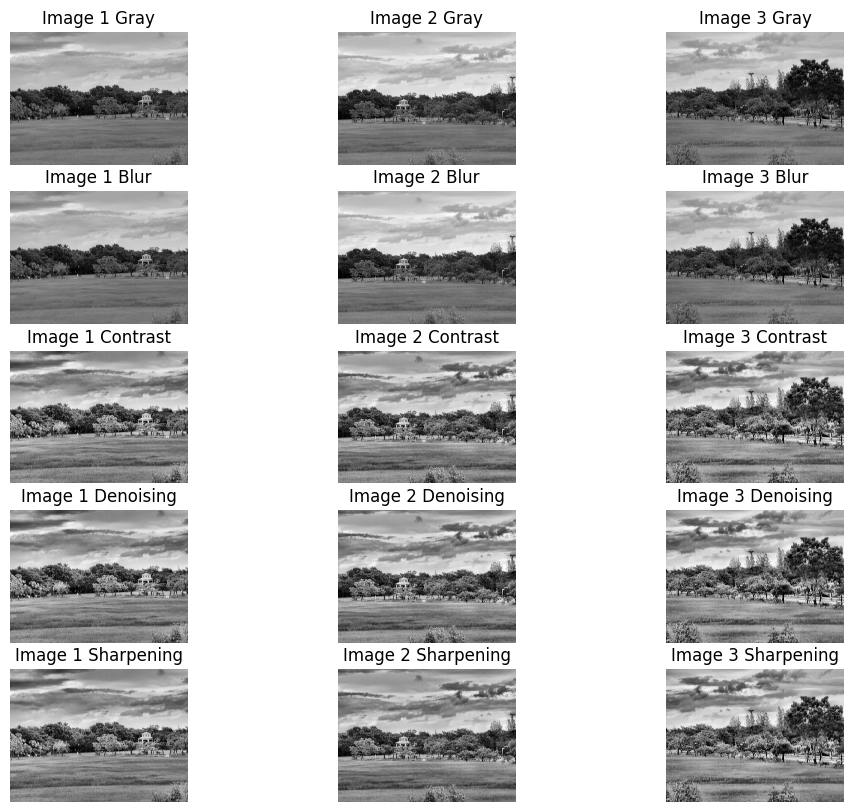

In [ ]:
# Convert images to grayscale
img1_gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2_gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
img3_gray = cv2.cvtColor(img3, cv2.COLOR_BGR2GRAY)

# GaussianBlur
img1_blur = cv2.GaussianBlur(img1_gray, (5,5), 0)
img2_blur = cv2.GaussianBlur(img2_gray, (5,5), 0)
img3_blur = cv2.GaussianBlur(img3_gray, (5,5), 0)

# CLAHE (ปรับ contrast)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
img1_eq = clahe.apply(img1_blur)
img2_eq = clahe.apply(img2_blur)
img3_eq = clahe.apply(img3_blur)

# Denoising (ใช้เฉพาะถ้าภาพมี noise เยอะ)
img1_denoise = cv2.fastNlMeansDenoising(img1_eq, h=10)
img2_denoise = cv2.fastNlMeansDenoising(img2_eq, h=10)
img3_denoise = cv2.fastNlMeansDenoising(img3_eq, h=10)

# Sharpening (เบา ๆ เพื่อให้ edges ชัด)
kernel_sharpen = np.array([[0,-1,0], [-1,5,-1], [0,-1,0]])
img1_preproc = cv2.filter2D(img1_denoise, -1, kernel_sharpen)
img2_preproc = cv2.filter2D(img2_denoise, -1, kernel_sharpen)
img3_preproc = cv2.filter2D(img3_denoise, -1, kernel_sharpen)

images = [img1_gray, img2_gray, img3_gray,
          img1_blur, img2_blur, img3_blur,
          img1_eq, img2_eq, img3_eq,
          img1_denoise, img2_denoise, img3_denoise,
          img1_preproc, img2_preproc, img3_preproc
          ]
titles = ["Image 1 Gray", "Image 2 Gray", "Image 3 Gray",
          "Image 1 Blur", "Image 2 Blur", "Image 3 Blur",
          "Image 1 Contrast", "Image 2 Contrast", "Image 3 Contrast",
          "Image 1 Denoising", "Image 2 Denoising", "Image 3 Denoising",
          "Image 1 Sharpening", "Image 2 Sharpening", "Image 3 Sharpening"
          ]

plt.figure(figsize=(12, 10))
for i, (img, title) in enumerate(zip(images, titles), 1):
    plt.subplot(5, 3, i)
    plt.imshow(img, cmap='gray')
    plt.title(title)
    plt.axis("off")
plt.show()

## ˖⋆˚✿˖° Paranoma (1 + 2)

### Feature detection

Detect keypoints and descriptors using algorithms like SIFT, ORB, SURF

| Algorithm | Robustness (Scale/Rotation/Light) | Speed              | descriptor                 | เหมาะกับงาน                 |
| --------- | --------------------------------- | ------------------ | --------------------------- | --------------------------- |
| **SIFT**  | ★★★★★ (ดีที่สุด)                  | ★★                 | 128-dimensional vector (float) → robust, แม่นยำ | Panorama, 3D reconstruction |
| **SURF**  | ★★★★☆                             | ★★★                | 64 หรือ 128-dimensional vector (float) → เร็วกว่านิดหน่อย       | งานที่ต้องการ balance       |
| **ORB**   | ★★★                               | ★★★★★ (เร็วที่สุด) | binary string (256-bit → 32-byte) → เร็วมาก เพราะใช้ Hamming distance         | Real-time, SLAM, AR         |

**Using SIFT (Scale-Invariant Feature Transform)**

ฟังก์ชัน `detectAndCompute` จะคืนค่า 2 ค่า ได้แก่
* `kp` (keypoints) - จุดเด่นที่ algorithm ตรวจเจอ (เช่น มุม, ขอบ, ลายจุด) → คือ พิกัดตำแหน่ง (x, y) บนภาพ
* `des`(descriptors)  - ลายนิ้วมือ ของ keypoint แต่ละจุด → เป็น vector ของตัวเลข ที่อธิบายว่าบริเวณรอบ ๆ keypoint นั้นมี pattern แบบไหน

เปรียบเทียบเพื่อให้เข้าใจง่ายขึ้น
* Keypoints = "ที่อยู่ของบ้าน" (เช่น บ้านเลขที่ 120/200)
* Descriptors = "ลักษณะบ้าน" (มีหลังคาสีแดง, หน้าต่าง 2 บาน, มีรั้ว)

In [ ]:
# สร้าง SIFT
sift = cv2.SIFT_create()

# Find the keypoints and descriptors with SIFT for each image
kp1, des1 = sift.detectAndCompute(img1_blur, None)
kp2, des2 = sift.detectAndCompute(img2_blur, None)
kp3, des3 = sift.detectAndCompute(img3_blur, None)

print("จำนวน keypoints ในภาพที่ 1:", len(kp1))
print("จำนวน keypoints ในภาพที่ 2:", len(kp2))
print("จำนวน keypoints ในภาพที่ 3:", len(kp3))

จำนวน keypoints ในภาพที่ 1: 10930
จำนวน keypoints ในภาพที่ 2: 9488
จำนวน keypoints ในภาพที่ 3: 17724


### Feature matching

Match the keypoints between the first two images.


**`cv2.BFMatcher()` (Brute-Force matcher)** - คำนวณระยะห่างระหว่าง descriptor แต่ละตัวจากชุดหนึ่ง กับทุกตัวในชุดอีกชุด มีพารามิเตอร์หลัก 2 ตัว ได้แก่
1. `normType` → ระบุว่าจะใช้ ระยะ (distance metric) แบบไหนในการวัดความต่างของ descriptors ค่าที่นิยมใช้
    * `cv2.NORM_L2` ใช้ Euclidean distance - เหมาะสำหรับ descriptors ที่เป็น float32 เช่น SIFT, SURF
    * `cv2.NORM_HAMMING` ใช้ Hamming distance (นับจำนวนบิตที่ต่างกัน) - เหมาะสำหรับ binary descriptors เช่น ORB, BRIEF, BRISK

2. `crossCheck` → เปิด/ปิดการบังคับ mutual best match (ค่าเริ่มต้น = False)
    * ถ้า `True` - matcher จะคืนเฉพาะ matches ที่เป็น mutual best match (A→B และ B→A ต้อง match กันพอดี)
        * ข้อดี - ลด false matches ได้ดีขึ้น
        * ข้อเสีย - จำนวน matches น้อยลง
    * ถ้า `False` - คืน matches ทั้งหมด (ใช้ร่วมกับ ratio test ของ Lowe's method จะยืดหยุ่นกว่า)

**`bf.knnMatch()`** เมธอดของ bf สำหรับหา k-nearest neighbors
1. `des1` - array ของ descriptors จากภาพที่เป็น query (ได้จาก detector.detectAndCompute(img1, None))
2. `des2` - array ของ descriptors จากภาพที่เป็น target (ได้จาก detector.detectAndCompute(img2, None))
3. `k=2` - จำนวน nearest neighbours ที่จะคืนมาสำหรับแต่ละ descriptor ใน des1 (นิยมใช้ k=2 เพื่อทำ Lowe's ratio test)

**Lowe's ratio test**
* เปรียบเทียบระยะของ match ที่ดีที่สุด (m) กับอันดับสอง (n)
* ถ้า m ดีกว่ามาก (เช่น m.distance < 0.75 * n.distance) → ถือว่า match นี้ "ชัดเจน"
* ถ้า m กับ n ใกล้เคียงกัน → match ไม่มั่นใจ → ทิ้งไป

In [ ]:
# ใช้ BFMatcher แบบ L2 norm
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)

# หา 2 nearest neighbors สำหรับแต่ละ descriptor ใน des1
matches = bf.knnMatch(des1, des2, k=2)

# Filtering ด้วย ratio test ของ Lowe’s method
good_matches = [m for m, n in matches if m.distance < 0.75 * n.distance]
print("จำนวน matches ที่เหลือหลัง filtering:", len(good_matches))

# Sort matches by distance
good_matches = sorted(good_matches, key=lambda x: x.distance)

# matches ไม่พอสำหรับหา homography (ต้องมี >= 4)
if len(good_matches) < 4:
    raise RuntimeError("matches ไม่พอ")

จำนวน matches ที่เหลือหลัง filtering: 793


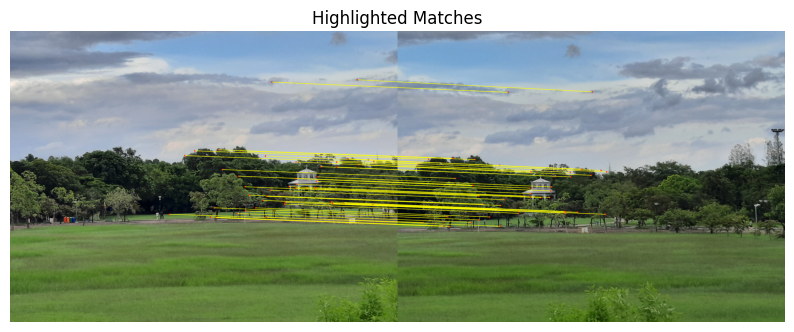

In [ ]:
match_img = cv2.drawMatchesKnn(
    img1, kp1,                                            # รูปที่หนึ่ง (source) และ keypoints ของมัน
    img2, kp2,                                            # รูปที่สอง (target) และ keypoints ของมัน
    [[m] for m in good_matches[:50]],                     # รายการ matches ที่จะวาด (จำกัดแค่ 50 ตัวแรก)
    None,                                                 # outImg: None => ให้ drawMatches คืนภาพใหม่แทนการเขียนทับภาพเดิม
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS     # บอกไม่ให้วาด keypoints ที่ ไม่มี match (จะวาดเฉพาะ keypoints ที่อยู่ใน good_matches)
)

# เอาความกว้างและความสูงของรูปภาพ จะใช้ w1 เพื่อชดเชยพิกัดของ keypoints ในรูปที่สอง เมื่อรวมภาพแบบ side-by-side
h1, w1 = img1.shape[:2]
H_match, W_match = match_img.shape[:2]

# วาดจุด/เส้นหนาเพิ่มเติมด้วย cv2.circle & cv2.line
for m in good_matches[:50]:
    # หาพิกัด
    x1, y1 = kp1[m.queryIdx].pt
    x2, y2 = kp2[m.trainIdx].pt

    p1 = (int(round(x1)), int(round(y1)))
    p2 = (int(round(x2 + w1)), int(round(y2)))  # ชดเชย x ด้วย w1

    # clip ให้แน่ใจว่าอยู่ในขอบภาพ
    p1 = (int(np.clip(p1[0], 0, W_match-1)), int(np.clip(p1[1], 0, H_match-1)))
    p2 = (int(np.clip(p2[0], 0, W_match-1)), int(np.clip(p2[1], 0, H_match-1)))

    cv2.circle(img=match_img, center=p1, radius=8, color=(0,0,255), thickness=-1) # จุดสีแดงใหญ่
    cv2.circle(match_img, p2, 8, (0, 0, 255), -1)
    cv2.line(match_img, p1, p2, (0, 255, 255), 3, lineType=cv2.LINE_AA) # เหลือง, anti-aliased

show_img(match_img, "Highlighted Matches")

### Find homography

Calculate the homography matrix between the first two images.


`cv2.findHomography()`

**Parameters**

* srcPoints
   * จุดต้นทาง (source points) จากภาพแรก
   * shape ที่รองรับ: (N,1,2) หรือ (N,2)
   * ประเภท: np.float32 หรือ np.float64
   * N ≥ 4 (ต้องมีอย่างน้อย 4 จุดถึงจะหาค่า homography ได้)

* dstPoints
   * จุดปลายทาง (destination points) จากภาพที่สอง
   * รูปแบบเหมือน srcPoints

* method (ค่า default = 0)
วิธีการคำนวณ homography:
   * 0 หรือ cv2.RANSAC → ใช้ RANSAC เพื่อลดผล outliers
   * cv2.LMEDS → ใช้วิธี Least-Median robust estimator
   * cv2.RHO → Robust Hyperplane Optimization (เร็วกว่า RANSAC ในบางกรณี)

* ransacReprojThreshold (ใช้กับ RANSAC หรือ RHO)
   * ค่า threshold (หน่วยเป็นพิกเซล) ที่ใช้ตัดสินว่า point ใดเป็น inlier หรือ outlier
   * เช่น 5.0 หมายถึง ถ้าจุด warp แล้วคลาดเคลื่อนเกิน 5 px → นับเป็น outlier

* maxIters (ใช้กับ RANSAC/RHO)
   * จำนวนรอบสูงสุดในการสุ่มเลือก subset ของจุด (default = 2000)

* confidence (ใช้กับ RANSAC/RHO)
   * ค่าความมั่นใจ (default = 0.995 หรือ 99.5%)
   * หมายถึงโอกาสที่เมทริกซ์ H ที่ได้ครอบคลุม inliers ส่วนใหญ่จริง ๆ

**Return Values**

H → Homography matrix ขนาด 3×3
* ถ้าคำนวณไม่ได้ จะคืนค่า None

mask → array ขนาด (N,1) ที่เป็น 0/1
* 1 = จุดนั้นเป็น inlier
* 0 = จุดนั้นเป็น outlier

In [ ]:
# Extract location of good matches
src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2) # shape (num_matches, 1, 2)
dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

# Find homography matrix using RANSAC
H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

print("Homography Matrix:\n", H)

inliers = int(mask.sum())
print("\ninliers:", inliers)
if inliers < 20:
    print("Warning: too few inliers — homography may be unreliable")

Homography Matrix:
 [[ 1.06458129e+00 -1.32896455e-02 -1.68390945e+03]
 [ 3.80572226e-02  1.03901581e+00  7.96408188e+00]
 [ 1.75946980e-05 -8.68921877e-07  1.00000000e+00]]

inliers: 664


### Warp image

Warp the second image onto the perspective of the first image.


In [ ]:
h1,w1 = img1.shape[:2]
h2,w2 = img2.shape[:2]

# กำหนดมุมสี่มุมของแต่ละภาพเป็นพิกัด [x,y]
# [0,0] = มุมบน-ซ้าย
# [0,h] = มุมล่าง-ซ้าย
# [w,h] = มุมล่าง-ขวา
# [w,0] = มุมบน-ขวา
corners1 = np.float32([[0,0],[0,h1],[w1,h1],[w1,0]]).reshape(-1,1,2)
corners2 = np.float32([[0,0],[0,h2],[w2,h2],[w2,0]]).reshape(-1,1,2)
# นำมุมของ img1 ไปผ่าน homography H เพื่อหา ตำแหน่งของมุม img1 หลังถูก warp ในระบบพิกัดของ img2
warped_corners = cv2.perspectiveTransform(corners1, H)

# รวมมุมที่ถูก warp ของ img1 กับมุมของ img2 เป็นชุดเดียว (รวมทั้งหมด 8 จุด)
all_corners = np.concatenate((warped_corners, corners2), axis=0)
xmin = int(np.floor(all_corners[:,:,0].min()))
ymin = int(np.floor(all_corners[:,:,1].min()))
xmax = int(np.ceil(all_corners[:,:,0].max()))
ymax = int(np.ceil(all_corners[:,:,1].max()))

t = [-xmin, -ymin] # ทางที่มันจะไป
Ht = np.array([[1,0,t[0]], [0,1,t[1]], [0,0,1]]) # ขยับภาพทั้งหมดให้พิกัดเริ่มต้นไม่ติดลบ

# คำนวณ t, Ht, xmax/xmin, ymax/ymin แล้ว
panorama12 = cv2.warpPerspective(img1, Ht.dot(H), (xmax-xmin, ymax-ymin))

# วาง img2 ลงไปบน panorama12 ในตำแหน่งที่ถูกต้อง
# การ slice ของ NumPy: array[row_start:row_end, col_start:col_end]
panorama12[t[1]:t[1]+h2, t[0]:t[0]+w2] = img2

```
t = [-xmin, -ymin]
Ht = np.array([[1,0,t[0]], [0,1,t[1]], [0,0,1]])
```
`t` = เวกเตอร์การแปล (translation) ที่จำเป็นเพื่อย้ายพิกัดให้ไม่มีค่าติดลบ ถ้า xmin เป็นลบ หมายความว่า warp ของ img1 ยืดออกนอกกรอบซ้าย → ต้องเลื่อนทั้งภาพขวาขึ้น -xmin พิกเซล

`Ht` = matrix 3×3 ของการแปล (homography แบบ identity + translation) ในรูป homogeneous coordinates

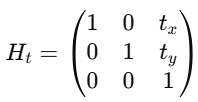

**cv2.warpPerspective(src, M, dsize)**
* src = ภาพต้นทาง (img1)
* M = เมทริกซ์ 3×3 ที่จะแปลงพิกัดของ src → พิกัดบนภาพผลลัพธ์ (destination). ในที่นี้ใช้ Ht.dot(H) ซึ่งแปลว่า ก่อนอื่นใช้ H (แมปจาก img1 → img2) แล้วใช้ Ht (เลื่อนผลลัพธ์ให้พอดีกับ canvas) ในทางคณิตศาสตร์จุดใหม่ = Ht * (H * p)
* dsize = ขนาดของภาพผลลัพธ์เป็น (width, height)  กว้าง = xmax-xmin, สูง = ymax-ymin

### Display result (first pair)


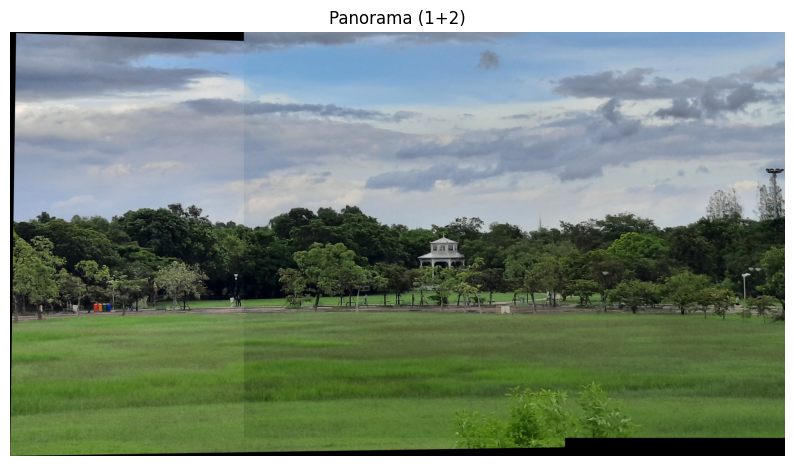

In [ ]:
show_img(panorama12, "Panorama (1+2)")

## ⋆˚✿˖° Paranoma (1 + 2 + 3)

### Preprocessing

In [ ]:
panorama12_gray = cv2.cvtColor(panorama12, cv2.COLOR_BGR2GRAY)
panorama12_blur = cv2.GaussianBlur(panorama12_gray, (5,5), 0)
panorama12_eq = clahe.apply(panorama12_blur)
panorama12_denoise = cv2.fastNlMeansDenoising(panorama12_eq, h=10)
panorama12_preproc = cv2.filter2D(panorama12_denoise, -1, kernel_sharpen)

### Feature detection

Detect keypoints and descriptors using algorithms like SIFT or ORB.


In [ ]:
kp12, des12 = sift.detectAndCompute(panorama12_preproc, None)

print("จำนวน keypoints ในภาพ panorama 1+2:", len(kp12))

จำนวน keypoints ในภาพ panorama 1+2: 26045


### Feature matching

Match the keypoints between the partial panorama and the third image.


In [ ]:
# ใช้ BFMatcher แบบ L2 norm
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)

# หา 2 nearest neighbors สำหรับแต่ละ descriptor ใน des1
matches_panorama3 = bf.knnMatch(des12, des3, k=2)

# Filtering ด้วย ratio test ของ Lowe’s method
good_matches_panorama3 = [m for m, n in matches_panorama3 if m.distance < 0.75 * n.distance]
print("จำนวน matches ที่เหลือหลัง filtering:", len(good_matches_panorama3))

# Sort matches by distance
good_matches_panorama3 = sorted(good_matches_panorama3, key=lambda x: x.distance)

# matches ไม่พอสำหรับหา homography (ต้องมี >= 4)
if len(good_matches_panorama3) < 4:
  raise RuntimeError("matches ไม่พอ")

จำนวน matches ที่เหลือหลัง filtering: 628


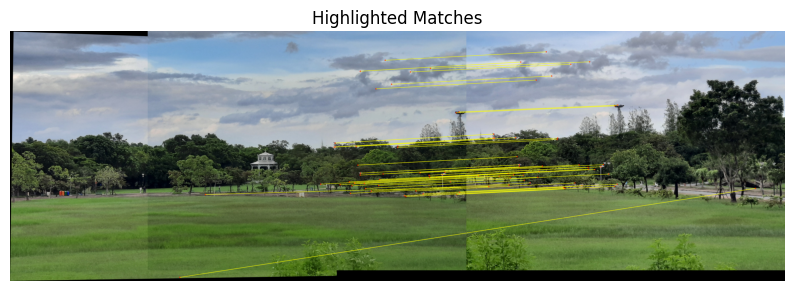

In [ ]:
match_img_3 = cv2.drawMatchesKnn(
    panorama12, kp12,
    img3, kp3,
     [[m] for m in good_matches_panorama3[:50]],
    None,
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
)

h12, w12 = panorama12.shape[:2]
H_match_panorama3, W_match_panorama3 = match_img_3.shape[:2]

for m in good_matches_panorama3[:50]:
    x1_3, y1_3 = kp12[m.queryIdx].pt
    x2_3, y2_3 = kp3[m.trainIdx].pt

    p1_3 = (int(round(x1_3)), int(round(y1_3)))
    p2_3 = (int(round(x2_3 + w12)), int(round(y2_3)))

    # clip ให้แน่ใจว่าอยู่ในขอบภาพ
    p1_3 = (int(np.clip(p1_3[0], 0, W_match_panorama3-1)), int(np.clip(p1_3[1], 0, H_match_panorama3-1)))
    p2_3 = (int(np.clip(p2_3[0], 0, W_match_panorama3-1)), int(np.clip(p2_3[1], 0, H_match_panorama3-1)))

    cv2.circle(img=match_img_3, center=p1_3, radius=8, color=(0,0,255), thickness=-1) # จุดสีแดงใหญ่
    cv2.circle(match_img_3, p2_3, 8, (0, 0, 255), -1)
    cv2.line(match_img_3, p1_3, p2_3, (0, 255, 255), 3, lineType=cv2.LINE_AA) # เหลือง, anti-aliased

show_img(match_img_3, "Highlighted Matches")


### Find homography

Calculate the homography matrix between the partial panorama and the third image.


In [ ]:
# Extract location of good matches
src_pts = np.float32([kp12[m.queryIdx].pt for m in good_matches_panorama3]).reshape(-1, 1, 2)
dst_pts = np.float32([kp3[m.trainIdx].pt for m in good_matches_panorama3]).reshape(-1, 1, 2)

# Find homography matrix using RANSAC
H_panorama3, mask_panorama3 = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

print("Homography Matrix:\n", H_panorama3)

inliers = int(mask.sum())
print("\ninliers:", inliers)
if inliers < 20:
    print("Warning: too few inliers — homography may be unreliable")

Homography Matrix:
 [[ 1.14042766e+00 -1.32143800e-02 -4.25597768e+03]
 [ 4.83844668e-02  1.11957871e+00 -3.50989854e+02]
 [ 2.38103377e-05  1.36923481e-06  1.00000000e+00]]

inliers: 664


### Warp image (third image)

Warp the third image onto the perspective of the partial panorama.


In [ ]:
# Get the height and width of the partial panorama image (panorama12)
h_pano, w_pano = panorama12.shape[:2]
# Get the height and width of the third image (img3)
h3, w3 = img3.shape[:2]

corners12 = np.float32([[0,0],[0,h_pano],[w_pano,h_pano],[w_pano,0]]).reshape(-1,1,2)
corners3 = np.float32([[0,0],[0,h3],[w3,h3],[w3,0]]).reshape(-1,1,2)
warped_corners_panorama3 = cv2.perspectiveTransform(corners12, H_panorama3)

all_corners_3 = np.concatenate((warped_corners_panorama3, corners3), axis=0)
[xmin3, ymin3] = np.int32(all_corners_3.min(axis=0).ravel() - 0.5)
[xmax3, ymax3] = np.int32(all_corners_3.max(axis=0).ravel() + 0.5)

t3 = [-xmin3, -ymin3]
Ht3 = np.array([[1,0,t3[0]], [0,1,t3[1]], [0,0,1]])

panorama123 = cv2.warpPerspective(panorama12, Ht3.dot(H_panorama3), (xmax3 - xmin3, ymax3 - ymin3))
panorama123[t3[1]:t3[1]+h3, t3[0]:t3[0]+w3] = img3

### Display result (final)


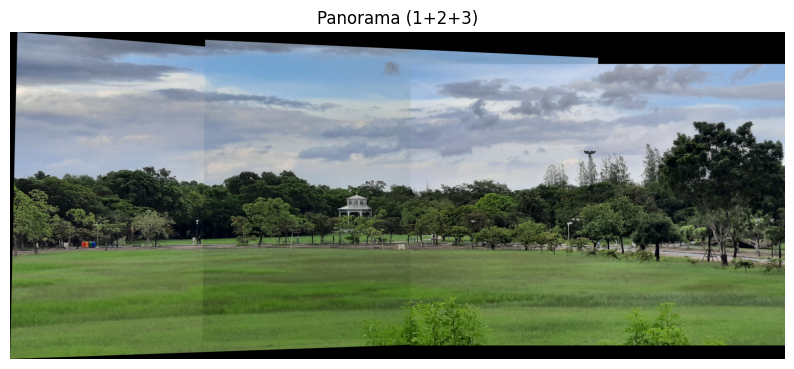

In [ ]:
show_img(panorama123, "Panorama (1+2+3)")

## Without Preprocessing


## ˖⋆˚✿˖° Paranoma (1 + 2)

### Feature detection

Detect keypoints and descriptors using algorithms like SIFT or ORB.


In [ ]:
# สร้าง SIFT
sift = cv2.SIFT_create()

# Find the keypoints and descriptors with ORB for each image
kp1_wop, des1_wop = sift.detectAndCompute(img1, None)
kp2_wop, des2_wop = sift.detectAndCompute(img2, None)
kp3_wop, des3_wop = sift.detectAndCompute(img3, None)

print("จำนวน keypoints ในภาพที่ 1:", len(kp1_wop))
print("จำนวน keypoints ในภาพที่ 2:", len(kp2_wop))
print("จำนวน keypoints ในภาพที่ 3:", len(kp3_wop))

จำนวน keypoints ในภาพที่ 1: 15668
จำนวน keypoints ในภาพที่ 2: 13992
จำนวน keypoints ในภาพที่ 3: 25473


### Feature matching

Match the keypoints between the first two images.


In [ ]:
bf_wop = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches_wop = bf_wop.knnMatch(des1_wop, des2_wop, k=2)
good_matches_wop = [m for m, n in matches_wop if m.distance < 0.75 * n.distance]
print("จำนวน matches ที่เหลือหลัง filtering:", len(good_matches_wop))

if len(good_matches_wop) < 4:
  raise RuntimeError("matches ไม่พอ")

จำนวน matches ที่เหลือหลัง filtering: 696


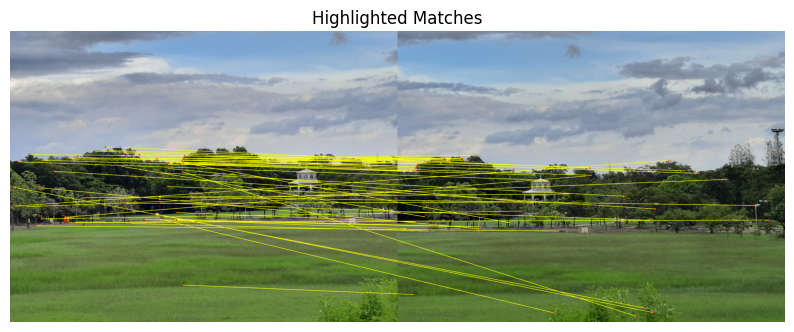

In [ ]:
match_img_wop = cv2.drawMatchesKnn(
    img1, kp1_wop,                                                                          # รูปที่หนึ่ง (source) และ keypoints ของมัน
    img2, kp2_wop,                                                                          # รูปที่สอง (target) และ keypoints ของมัน
    [[m] for m in good_matches_wop[:50]],                                        # รายการ matches ที่จะวาด (จำกัดแค่ 50 ตัวแรก)
    None,                                                                                 # outImg: None => ให้ drawMatches คืนภาพใหม่แทนการเขียนทับภาพเดิม
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS     # บอกไม่ให้วาด keypoints ที่ ไม่มี match (จะวาดเฉพาะ keypoints ที่อยู่ใน good_matches)
)

# เอาความกว้างและความสูงของรูปภาพ จะใช้ w1 เพื่อชดเชยพิกัดของ keypoints ในรูปที่สอง เมื่อรวมภาพแบบ side-by-side
h1_wop, w1_wop = img1.shape[:2]
H_match_wop, W_match_wop = match_img_wop.shape[:2]

# วาดจุด/เส้นหนาเพิ่มเติมด้วย cv2.circle & cv2.line
for m in good_matches_wop[:50]:
    # หาพิกัด
    x1_wop, y1_wop = kp1_wop[m.queryIdx].pt
    x2_wop, y2_wop = kp2_wop[m.trainIdx].pt

    p1_wop = (int(round(x1_wop)), int(round(y1_wop)))
    p2_wop = (int(round(x2_wop + w1_wop)), int(round(y2_wop)))  # ชดเชย x ด้วย w1

    # clip ให้แน่ใจว่าอยู่ในขอบภาพ
    p1_wop = (int(np.clip(p1_wop[0], 0, W_match_wop-1)), int(np.clip(p1_wop[1], 0, H_match_wop-1)))
    p2_wop = (int(np.clip(p2_wop[0], 0, W_match_wop-1)), int(np.clip(p2_wop[1], 0, H_match_wop-1)))

    cv2.circle(img=match_img_wop, center=p1_wop, radius=8, color=(0,0,255), thickness=-1) # จุดสีแดงใหญ่
    cv2.circle(match_img_wop, p2_wop, 8, (0, 0, 255), -1)
    cv2.line(match_img_wop, p1_wop, p2_wop, (0, 255, 255), 3, lineType=cv2.LINE_AA) # เหลือง, anti-aliased

show_img(match_img_wop, "Highlighted Matches")

### Find homography

Calculate the homography matrix between the first two images.


In [ ]:
# Extract location of good matches
src_pts_wop = np.float32([kp1_wop[m.queryIdx].pt for m in good_matches_wop]).reshape(-1, 1, 2)
dst_pts_wop = np.float32([kp2_wop[m.trainIdx].pt for m in good_matches_wop]).reshape(-1, 1, 2)

# Find homography matrix using RANSAC
H_wop, mask_wop = cv2.findHomography(src_pts_wop, dst_pts_wop, cv2.RANSAC, 5.0)

print("Homography Matrix:\n", H_wop)

inliers = int(mask_wop.sum())
print("\ninliers:", inliers)
if inliers < 20:
    print("Warning: too few inliers — homography may be unreliable")

Homography Matrix:
 [[ 1.06821602e+00 -1.80566365e-02 -1.68542789e+03]
 [ 4.13944126e-02  1.03307680e+00  9.71709937e+00]
 [ 1.94180427e-05 -3.57723935e-06  1.00000000e+00]]

inliers: 573


### Warp image

Warp the second image onto the perspective of the first image.


In [ ]:
h1_wop, w1_wop = img1.shape[:2]
h2_wop, w2_wop = img2.shape[:2]

corners1_wop = np.float32([[0,0],[0,h1_wop],[w1_wop,h1_wop],[w1_wop,0]]).reshape(-1,1,2)
corners2_wop = np.float32([[0,0],[0,h2_wop],[w2_wop,h2_wop],[w2_wop,0]]).reshape(-1,1,2)
warped_corners_wop = cv2.perspectiveTransform(corners1_wop, H_wop)

all_corners_wop = np.concatenate((warped_corners_wop, corners2_wop), axis=0)
xmin_wop = int(np.floor(all_corners_wop[:,:,0].min()))
ymin_wop = int(np.floor(all_corners_wop[:,:,1].min()))
xmax_wop = int(np.ceil(all_corners_wop[:,:,0].max()))
ymax_wop = int(np.ceil(all_corners_wop[:,:,1].max()))

t_wop = [-xmin_wop, -ymin_wop] # ทางที่มันจะไป
Ht_wop = np.array([[1,0,t_wop[0]], [0,1,t_wop[1]], [0,0,1]]) # ขยับภาพทั้งหมดให้พิกัดเริ่มต้นไม่ติดลบ

panorama12_wop = cv2.warpPerspective(img1, Ht_wop.dot(H_wop), (xmax_wop - xmin_wop, ymax_wop - ymin_wop))
panorama12_wop[t_wop[1]:t_wop[1]+h2_wop, t_wop[0]:t_wop[0]+w2_wop] = img2

### Display result (first pair)


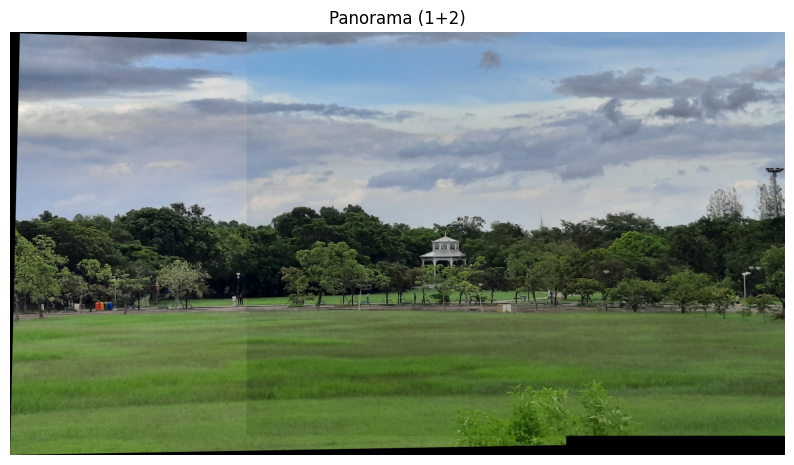

In [ ]:
show_img(panorama12_wop, "Panorama (1+2)")

## ⋆˚✿˖° Paranoma (1 + 2 + 3)

### Feature detection

Detect keypoints and descriptors using algorithms like SIFT or ORB.


In [ ]:
kp12_wop, des12_wop = sift.detectAndCompute(panorama12_wop, None)

print("จำนวน keypoints ในภาพ panorama 1+2:", len(kp12_wop))

จำนวน keypoints ในภาพ panorama 1+2: 21269


### Feature matching

Match the keypoints between the partial panorama and the third image.


In [ ]:
bf_wop = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches_panorama3_wop = bf_wop.knnMatch(des12_wop, des3_wop, k=2)
good_matches_panorama3_wop = [m for m, n in matches_panorama3_wop if m.distance < 0.75 * n.distance]
print("จำนวน matches ที่เหลือหลัง filtering:", len(good_matches_panorama3_wop))

if len(good_matches_panorama3_wop) < 4:
  raise RuntimeError("matches ไม่พอ")

จำนวน matches ที่เหลือหลัง filtering: 580


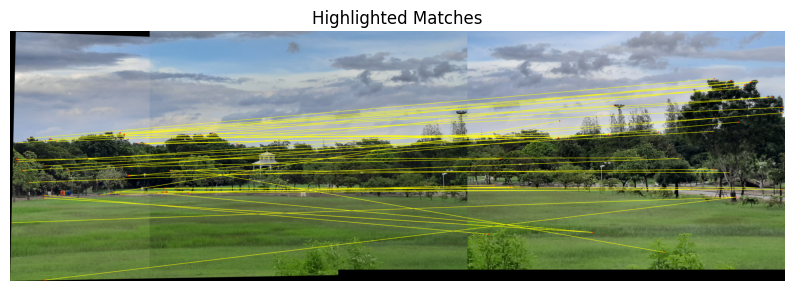

In [ ]:
match_img_3_wop = cv2.drawMatchesKnn(
    panorama12_wop, kp12_wop,                                               # รูปที่หนึ่ง (source) และ keypoints ของมัน
    img3, kp3_wop,                                                                   # รูปที่สอง (target) และ keypoints ของมัน
    [[m] for m in good_matches_panorama3_wop[:50]],               # รายการ matches ที่จะวาด (จำกัดแค่ 50 ตัวแรก)
    None,                                                                                 # outImg: None => ให้ drawMatches คืนภาพใหม่แทนการเขียนทับภาพเดิม
    flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS     # บอกไม่ให้วาด keypoints ที่ ไม่มี match (จะวาดเฉพาะ keypoints ที่อยู่ใน good_matches)
)

# เอาความกว้างและความสูงของรูปภาพ จะใช้ w1 เพื่อชดเชยพิกัดของ keypoints ในรูปที่สอง เมื่อรวมภาพแบบ side-by-side
h12_wop, w12_wop = panorama12_wop.shape[:2]
H_match_wop_3, W_match_wop_3 = match_img_3_wop.shape[:2]

# วาดจุด/เส้นหนาเพิ่มเติมด้วย cv2.circle & cv2.line
for m in good_matches_panorama3_wop[:50]:
    # หาพิกัด
    x1_wop_3, y1_wop_3 = kp12_wop[m.queryIdx].pt
    x2_wop_3, y2_wop_3 = kp3_wop[m.trainIdx].pt

    p1_wop_3 = (int(round(x1_wop_3)), int(round(y1_wop_3)))
    p2_wop_3 = (int(round(x2_wop_3 + w12_wop)), int(round(y2_wop_3)))  # ชดเชย x ด้วย w1

    # clip ให้แน่ใจว่าอยู่ในขอบภาพ
    p1_wop_3 = (int(np.clip(p1_wop_3[0], 0, W_match_wop_3-1)), int(np.clip(p1_wop_3[1], 0, H_match_wop_3-1)))
    p2_wop_3 = (int(np.clip(p2_wop_3[0], 0, W_match_wop_3-1)), int(np.clip(p2_wop_3[1], 0, H_match_wop_3-1)))

    cv2.circle(img=match_img_3_wop, center=p1_wop_3, radius=8, color=(0,0,255), thickness=-1) # จุดสีแดงใหญ่
    cv2.circle(match_img_3_wop, p2_wop_3, 8, (0, 0, 255), -1)
    cv2.line(match_img_3_wop, p1_wop_3, p2_wop_3, (0, 255, 255), 3, lineType=cv2.LINE_AA) # เหลือง, anti-aliased

show_img(match_img_3_wop, "Highlighted Matches")

### Find homography

Calculate the homography matrix between the partial panorama and the third image.


In [ ]:
# Extract location of good matches
src_pts_wop = np.float32([kp12_wop[m.queryIdx].pt for m in good_matches_panorama3_wop]).reshape(-1, 1, 2)
dst_pts_wop = np.float32([kp3_wop[m.trainIdx].pt for m in good_matches_panorama3_wop]).reshape(-1, 1, 2)

# Find homography matrix using RANSAC
H_panorama3_wop, mask_panorama3_wop = cv2.findHomography(src_pts_wop, dst_pts_wop, cv2.RANSAC, 5.0)

print("Homography Matrix:\n", H_panorama3_wop)

inliers = int(mask.sum())
print("\ninliers:", inliers)
if inliers < 20:
    print("Warning: too few inliers — homography may be unreliable")

Homography Matrix:
 [[ 1.12720421e+00 -1.44779598e-02 -4.23743167e+03]
 [ 4.46172576e-02  1.10426297e+00 -3.28193486e+02]
 [ 2.17268516e-05 -4.01771966e-07  1.00000000e+00]]

inliers: 664


### Warp image (third image)

Warp the third image onto the perspective of the partial panorama.


In [ ]:
h_pano_wop, w_pano_wop = panorama12_wop.shape[:2]
h3_wop, w3_wop = img3.shape[:2]

corners12_wop = np.float32([[0,0],[0,h_pano_wop],[w_pano_wop,h_pano_wop],[w_pano_wop,0]]).reshape(-1,1,2)
corners3_wop = np.float32([[0,0],[0,h3_wop],[w3_wop,h3_wop],[w3_wop,0]]).reshape(-1,1,2)
warped_corners_panorama3_wop = cv2.perspectiveTransform(corners12_wop, H_panorama3_wop)

all_corners_3_wop = np.concatenate((warped_corners_panorama3_wop, corners3_wop), axis=0)
xmin_wop_3 = int(np.floor(all_corners_3_wop[:,:,0].min()))
ymin_wop_3 = int(np.floor(all_corners_3_wop[:,:,1].min()))
xmax_wop_3 = int(np.ceil(all_corners_3_wop[:,:,0].max()))
ymax_wop_3 = int(np.ceil(all_corners_3_wop[:,:,1].max()))

t3_wop = [-xmin_wop_3, -ymin_wop_3]
Ht3_wop = np.array([[1,0,t3_wop[0]], [0,1,t3_wop[1]], [0,0,1]])

panorama123_wop = cv2.warpPerspective(panorama12_wop, Ht3.dot(H_panorama3_wop), (xmax_wop_3 - xmin_wop_3, ymax_wop_3 - ymin_wop_3))
panorama123_wop[t3_wop[1]:t3_wop[1]+h3_wop, t3_wop[0]:t3_wop[0]+w3_wop] = img3

### Display result (final)


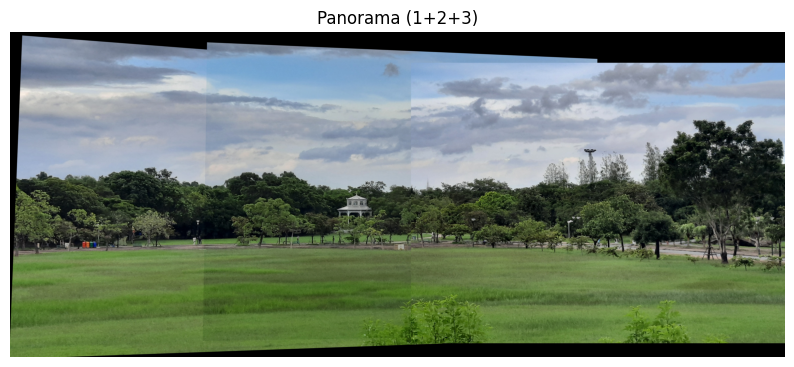

In [ ]:
show_img(panorama123_wop, "Panorama (1+2+3)")

## ⋆｡‧˚ʚ Show All ɞ˚‧｡⋆

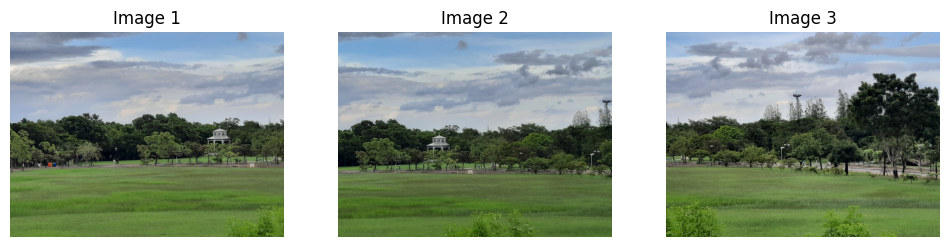

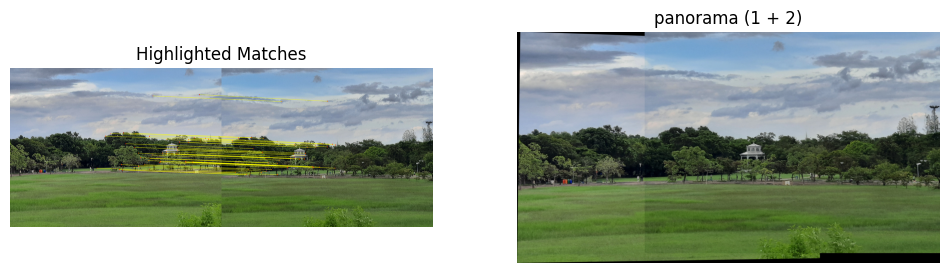

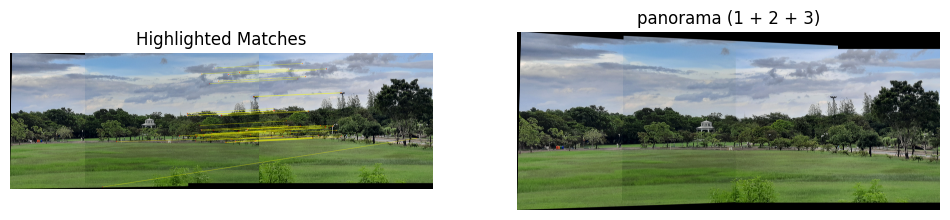

In [ ]:
# original images
images = [img1, img2, img3]
titles = ["Image 1", "Image 2", "Image 3"]

plt.figure(figsize=(12, 5))

for i, (img, title) in enumerate(zip(images, titles), 1):
    plt.subplot(1, len(images), i)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis("off")

plt.show()

# panorama (1 + 2)
images = [match_img, panorama12]
titles = ["Highlighted Matches", "panorama (1 + 2)"]

plt.figure(figsize=(12, 5))

for i, (img, title) in enumerate(zip(images, titles), 1):
    plt.subplot(1, len(images), i)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis("off")

plt.show()

# panorama (1 + 2 + 3)
images = [match_img_3, panorama123]
titles = ["Highlighted Matches", "panorama (1 + 2 + 3)"]

plt.figure(figsize=(12, 5))

for i, (img, title) in enumerate(zip(images, titles), 1):
    plt.subplot(1, len(images), i)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis("off")

plt.show()

## Comparison between with and without preprocessing step

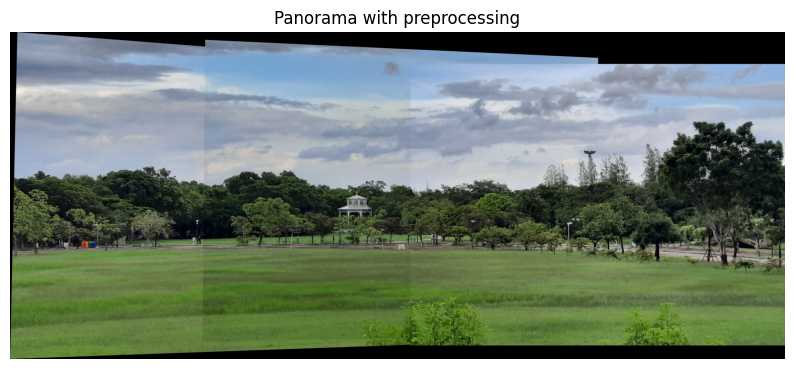

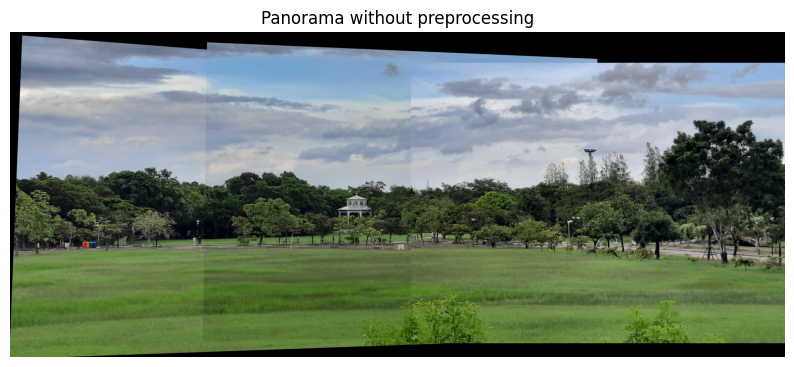

In [ ]:
show_img(panorama123, "Panorama with preprocessing")
show_img(panorama123_wop, "Panorama without preprocessing")

**เปรียบเทียบ Image Stitching (With vs Without Preprocessing)**

| Metric                 | **With Preprocessing** | **Without Preprocessing** | สรุป                                                                    |
| ---------------------- | ---------------------- | ------------------------- | ----------------------------------------------------------------------- |
| Keypoints (ภาพที่ 1)   | 10,930                 | 15,668                    | preprocessing ทำให้ keypoints ลดลง (feature ชัดเจนขึ้น ไม่กระจัดกระจาย) |
| Keypoints (ภาพที่ 2)   | 9,488                  | 13,992                    | ลดลง แต่โฟกัสไปที่ feature ที่มีคุณภาพมากกว่า                           |
| Keypoints (ภาพที่ 3)   | 17,724                 | 25,473                    | ลดลงเช่นกัน                                                             |
| Matches หลัง filtering | 793                    | 696                       | preprocessing ช่วยเพิ่ม **matches ที่ดีขึ้น**                           |
| Inliers จาก Homography | **664**                | 573                       | preprocessing ทำให้ inliers มากขึ้น → homography เสถียรกว่า             |


**วิเคราะห์เปรียบเทียบ**

* Without preprocessing
    * Keypoints เยอะ มี noise มาก มีโอกาสเกิด false matches สูง
    * Matches และ Inliers น้อยกว่า ไม่ค่อยมีความแม่นยำ

* With preprocessing:
    * Keypoints น้อย แต่โฟกัสไปที่จุดสำคัญจริง ๆ
    * Matches และ Inliers มากกว่า มีความแม่นยำสูง ได้ homography ที่เสถียรและ stitching ที่แม่นกว่า

# Show results from 10 data sets

In [ ]:
# --------------------------
# Helper: Show panorama with originals
# --------------------------
def show_group_with_panorama(images, pano, set_name="Set"):
    n = len(images)
    plt.figure(figsize=(5*n, 8))

    # แถวแรก: รูปต้นฉบับ
    for i, img in enumerate(images, 1):
        plt.subplot(2, n, i)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f"{set_name} - Image {i}")
        plt.axis("off")

    # แถวสอง: panorama (เต็มแถว)
    plt.subplot(2, 1, 2)
    plt.imshow(cv2.cvtColor(pano, cv2.COLOR_BGR2RGB))
    plt.title(f"{set_name} - Panorama")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

# --------------------------
# Preprocessing
# --------------------------
def preprocess(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5,5), 0)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    eq = clahe.apply(blur)
    denoise = cv2.fastNlMeansDenoising(eq, h=10)
    kernel_sharpen = np.array([[0,-1,0], [-1,5,-1], [0,-1,0]])
    sharp = cv2.filter2D(denoise, -1, kernel_sharpen)
    return sharp

# --------------------------
# Stitch 2 images
# --------------------------
def stitch_two(img1, img2, sift):
    img1_p = preprocess(img1)
    img2_p = preprocess(img2)

    kp1, des1 = sift.detectAndCompute(img1_p, None)
    kp2, des2 = sift.detectAndCompute(img2_p, None)

    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    matches = bf.knnMatch(des1, des2, k=2)
    good_matches = [m for m, n in matches if m.distance < 0.75 * n.distance]

    if len(good_matches) < 4:
        raise RuntimeError("Not enough matches to stitch")

    src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1,1,2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1,1,2)

    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    if H is None:
        raise RuntimeError("Homography calculation failed")

    h1,w1 = img1.shape[:2]
    h2,w2 = img2.shape[:2]
    corners1 = np.float32([[0,0],[0,h1],[w1,h1],[w1,0]]).reshape(-1,1,2)
    corners2 = np.float32([[0,0],[0,h2],[w2,h2],[w2,0]]).reshape(-1,1,2)
    warped_corners = cv2.perspectiveTransform(corners1, H)
    all_corners = np.concatenate((warped_corners, corners2), axis=0)

    xmin = int(np.floor(all_corners[:,:,0].min()))
    ymin = int(np.floor(all_corners[:,:,1].min()))
    xmax = int(np.ceil(all_corners[:,:,0].max()))
    ymax = int(np.ceil(all_corners[:,:,1].max()))

    t = [-xmin, -ymin]
    Ht = np.array([[1,0,t[0]], [0,1,t[1]], [0,0,1]])
    panorama = cv2.warpPerspective(img1, Ht.dot(H), (xmax-xmin, ymax-ymin))
    panorama[t[1]:t[1]+h2, t[0]:t[0]+w2] = img2

    return panorama

# --------------------------
# Stitch multiple images
# --------------------------
def stitch_images(images):
    sift = cv2.SIFT_create()
    panorama = images[0]
    for i in range(1, len(images)):
        panorama = stitch_two(panorama, images[i], sift)
    return panorama

In [ ]:
root10 = "/content/drive/MyDrive/CP461/Mini_Project/images/Dataset-Images"

groups = {
    "set_a": ["a1.jpg", "a2.jpg", "a3.jpg"],
    "set_b": ["b1.jpg", "b2.jpg", "b3.jpg"],
    "set_c": ["c1.jpg", "c2.jpg", "c3.jpg"],
    "set_d": ["d1.jpg", "d2.jpg", "d3.jpg"],
    "set_e": ["e1.jpg", "e2.jpg", "e3.jpg"],
    "set_f": ["f1.jpg", "f2.jpg", "f3.jpg"],
    "set_g": ["g1.jpg", "g2.jpg", "g3.jpg"],
    "set_h": ["h1.jpg", "h2.jpg", "h3.jpg"],
    "set_i": ["i1.jpg", "i2.jpg", "i3.jpg"],
    "set_j": ["j1.jpg", "j2.jpg", "j3.jpg"]
}

## ᯓᰔ Set 1

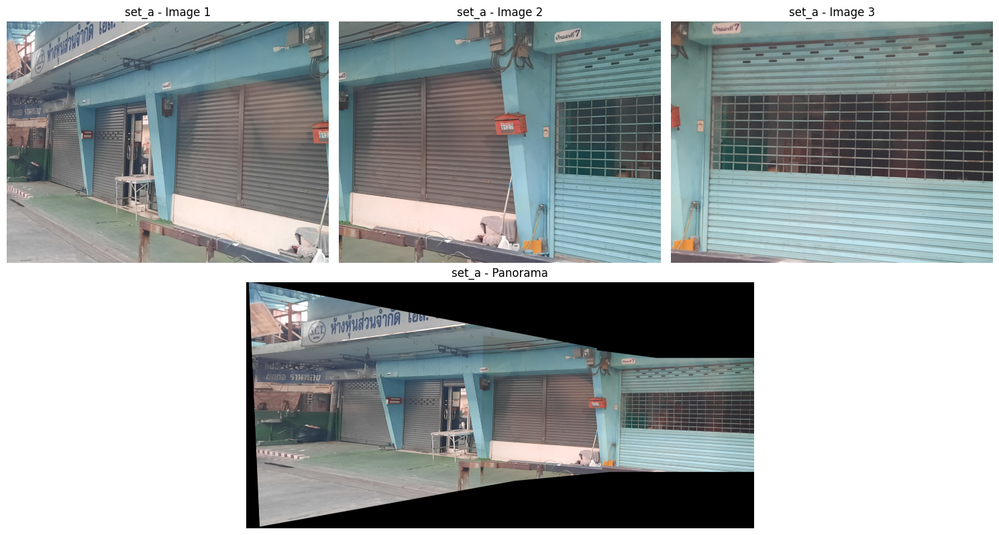

In [ ]:
imgs = [cv2.imread(f"{root10}/{f}") for f in groups["set_a"]]
pano = stitch_images(imgs)
show_group_with_panorama(imgs, pano, "set_a")

## ᯓᰔ Set 2

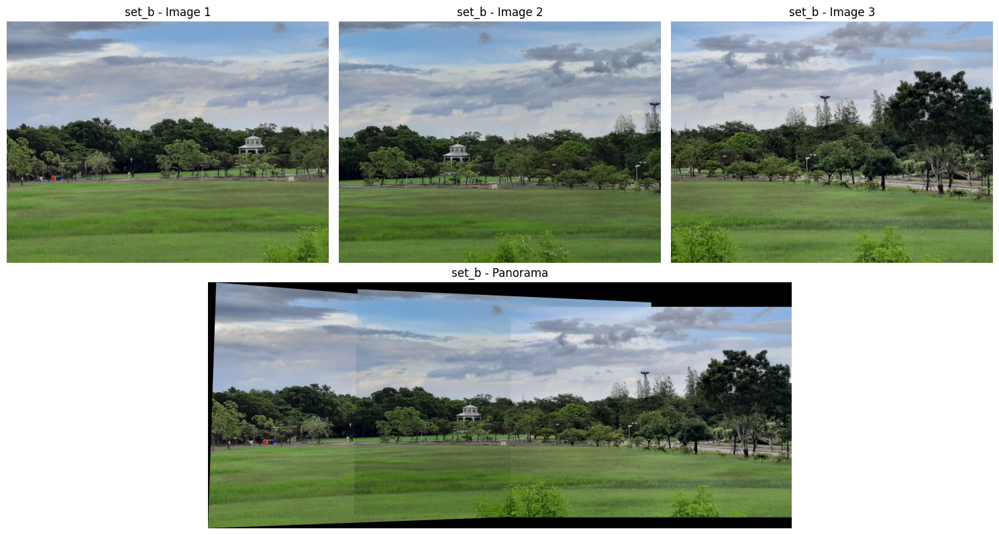

In [ ]:
imgs = [cv2.imread(f"{root10}/{f}") for f in groups["set_b"]]
pano = stitch_images(imgs)
show_group_with_panorama(imgs, pano, "set_b")

## ᯓᰔ Set 3

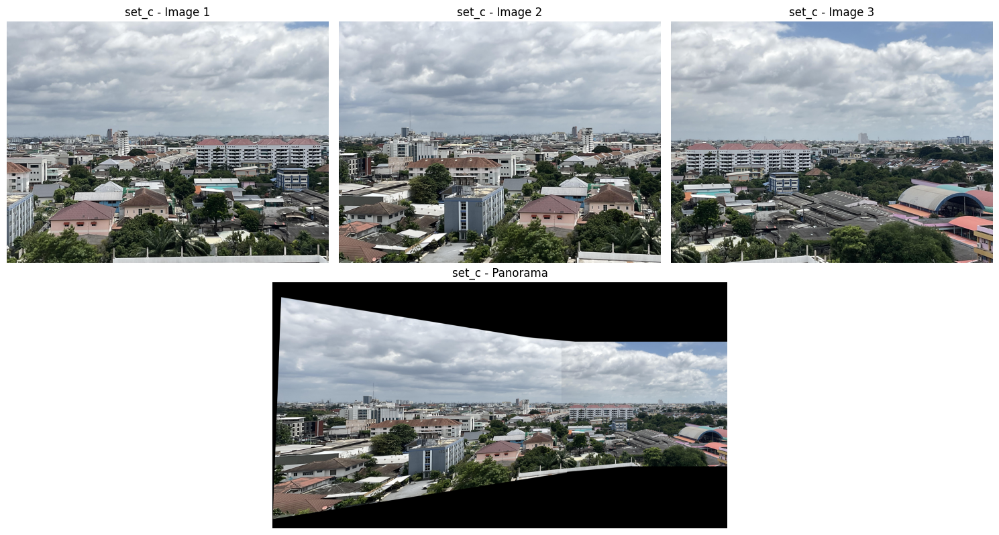

In [ ]:
imgs = [cv2.imread(f"{root10}/{f}") for f in groups["set_c"]]
pano = stitch_images(imgs)
show_group_with_panorama(imgs, pano, "set_c")

## ᯓᰔ Set 4

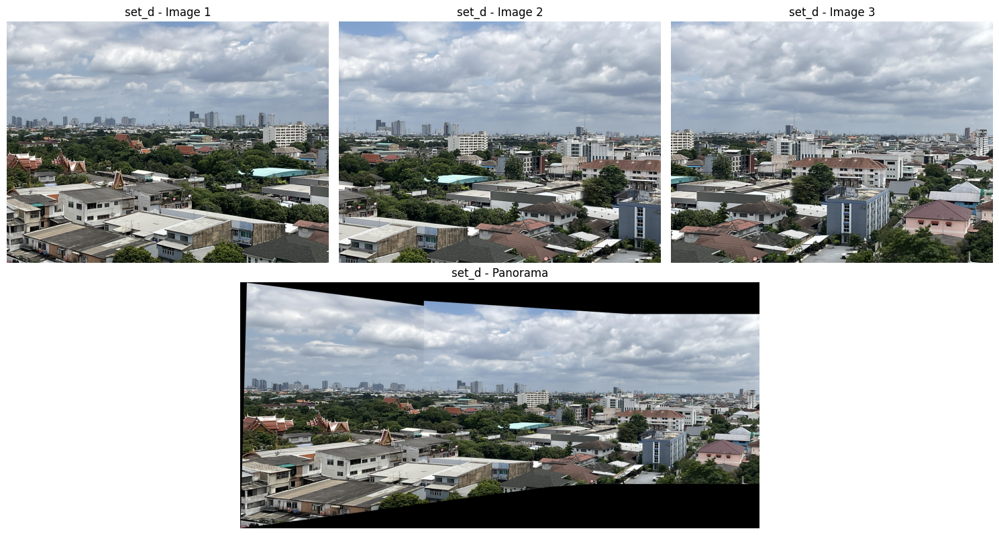

In [ ]:
imgs = [cv2.imread(f"{root10}/{f}") for f in groups["set_d"]]
pano = stitch_images(imgs)
show_group_with_panorama(imgs, pano, "set_d")

## ᯓᰔ Set 5

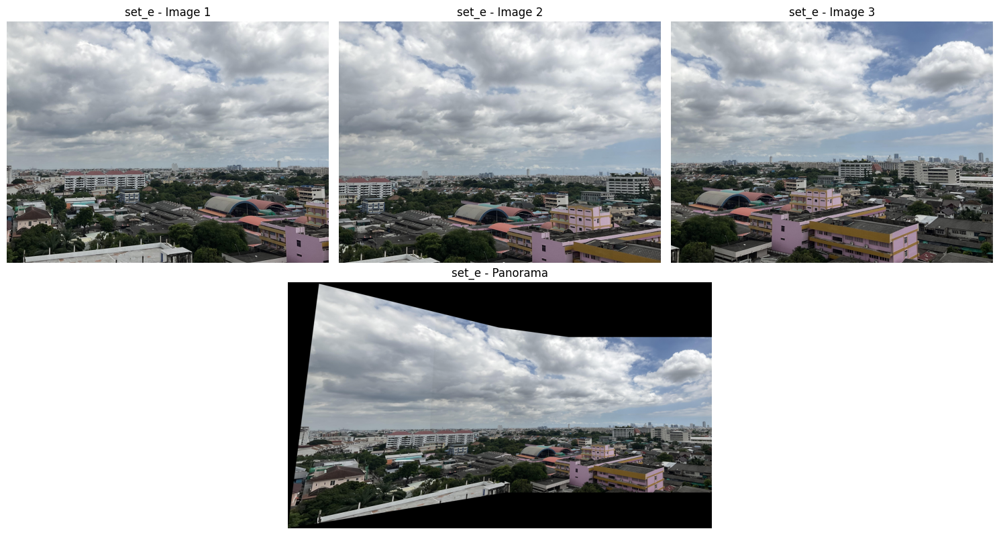

In [ ]:
imgs = [cv2.imread(f"{root10}/{f}") for f in groups["set_e"]]
pano = stitch_images(imgs)
show_group_with_panorama(imgs, pano, "set_e")

## ᯓᰔ Set 6

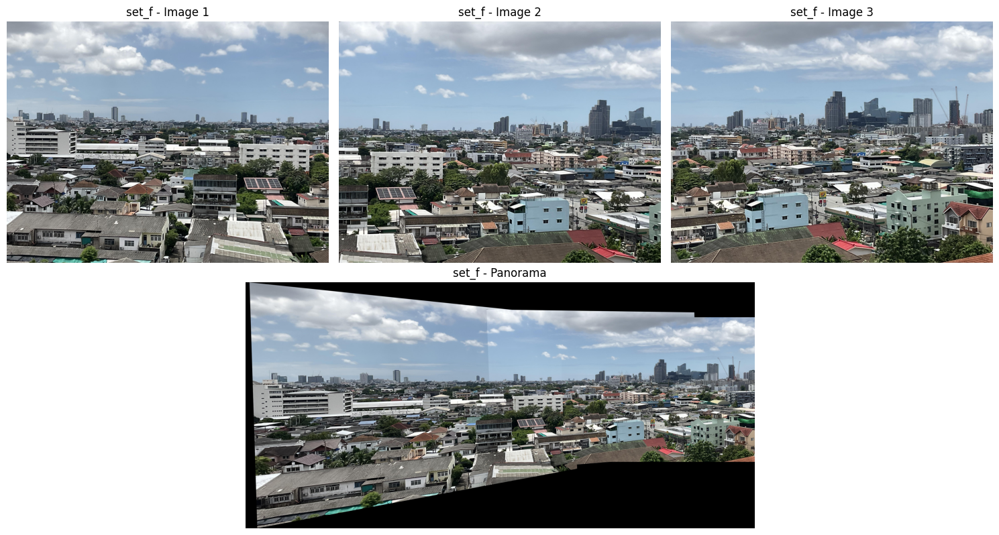

In [ ]:
imgs = [cv2.imread(f"{root10}/{f}") for f in groups["set_f"]]
pano = stitch_images(imgs)
show_group_with_panorama(imgs, pano, "set_f")

## ᯓᰔ Set 7

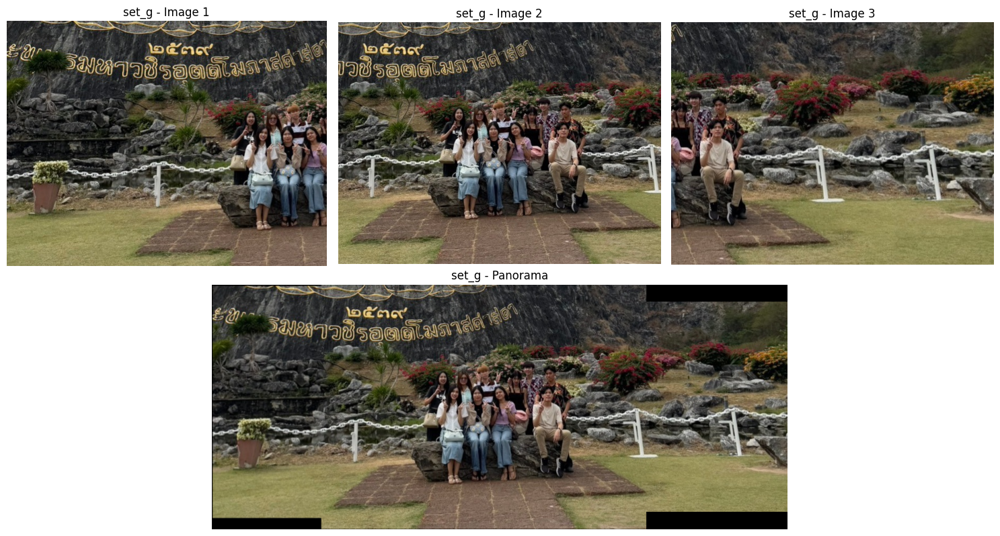

In [ ]:
imgs = [cv2.imread(f"{root10}/{f}") for f in groups["set_g"]]
pano = stitch_images(imgs)
show_group_with_panorama(imgs, pano, "set_g")

## ᯓᰔ Set 8

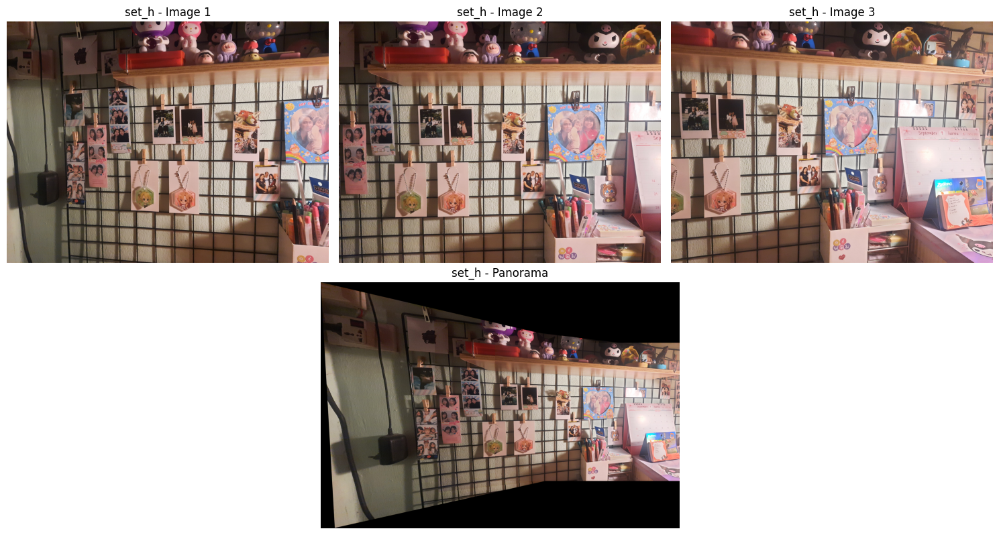

In [ ]:
imgs = [cv2.imread(f"{root10}/{f}") for f in groups["set_h"]]
pano = stitch_images(imgs)
show_group_with_panorama(imgs, pano, "set_h")

## ᯓᰔ Set 9

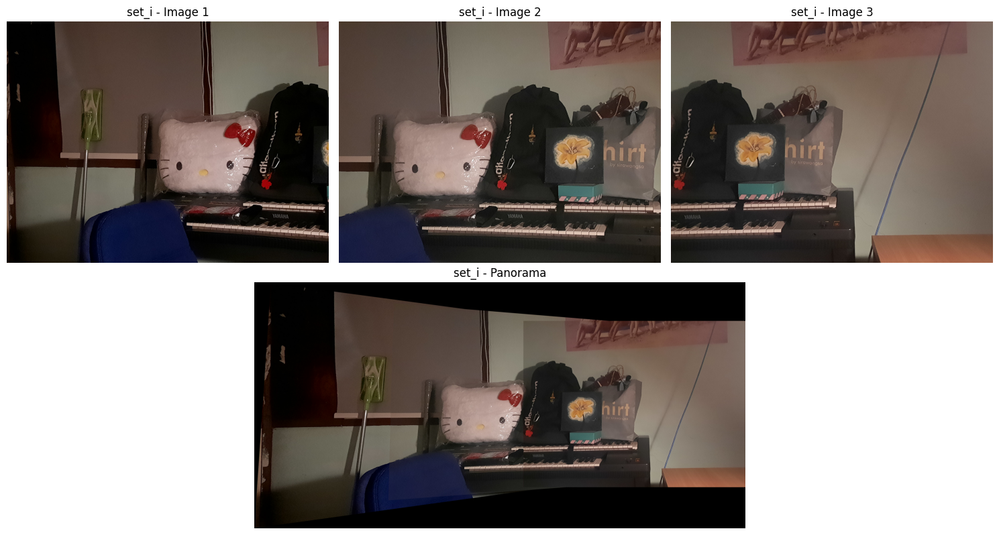

In [ ]:
imgs = [cv2.imread(f"{root10}/{f}") for f in groups["set_i"]]
pano = stitch_images(imgs)
show_group_with_panorama(imgs, pano, "set_i")

## ᯓᰔ Set 10

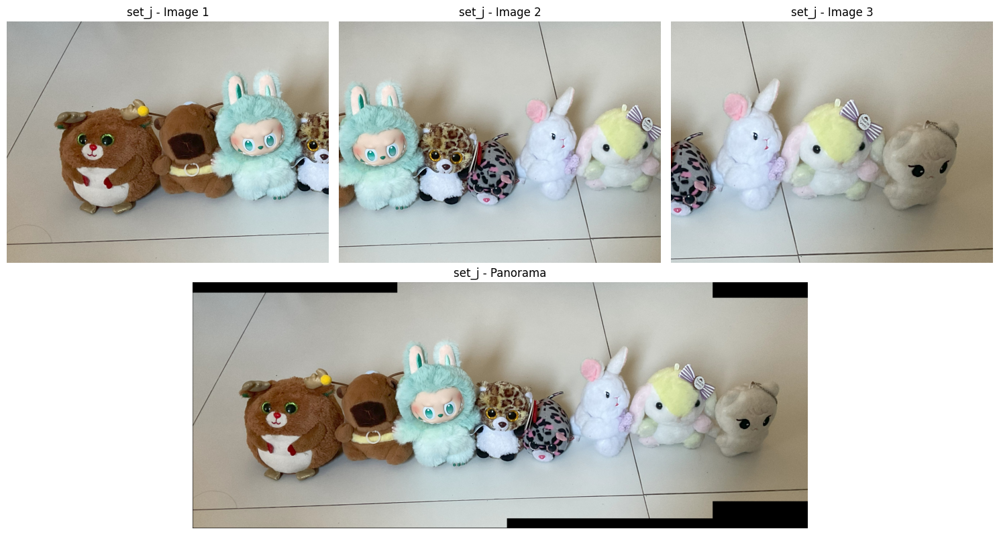

In [ ]:
imgs = [cv2.imread(f"{root10}/{f}") for f in groups["set_j"]]
pano = stitch_images(imgs)
show_group_with_panorama(imgs, pano, "set_j")